In [1]:
import datetime
import datetime as dt
import math
import os
from datetime import datetime, timedelta
from math import sqrt

import matplotlib.pyplot as plt
import matplotlib.ticker as mtick
import numpy as np
import pandas as pd
import pandas_profiling
import plotly as py
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
import requests
import seaborn as sns
import statsmodels.api as sm
import torch.nn.functional as F
from dateutil.easter import easter
from formulas import *
from numpy.random import normal, seed
from pandas.plotting import autocorrelation_plot
from plotly.offline import download_plotlyjs, init_notebook_mode, iplot, plot
from plotly.subplots import make_subplots
from prophet import Prophet

%matplotlib inline
from pylab import rcParams
from scipy.stats import norm
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.arima_model import ARIMA, ARMA
from statsmodels.tsa.arima_process import ArmaProcess
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller
from ta import add_all_ta_features
from ta.utils import dropna

%matplotlib inline
from torch import nn

rcParams["figure.figsize"] = 20, 20


# for tsa
import statsmodels.api as sm

# to evaluated performance using rmse
# to evaluated performance using rmse
from sklearn.metrics import mean_squared_error

# holt's linear trend model.
# holt's linear trend model.
from statsmodels.tsa.api import Holt

## import written functions


plt.style.use("bmh")

In [2]:
Tesla = pd.read_csv("tesla.csv")

In [3]:
Tesla.Date = pd.to_datetime(Tesla.Date)
Tesla.set_index("Date", inplace=True)
Tesla.head()

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2010-06-29,19.000000,25.00,17.540001,23.889999,23.889999,18766300
2010-06-30,25.790001,30.42,23.299999,23.830000,23.830000,17187100
2010-07-01,25.000000,25.92,20.270000,21.959999,21.959999,8218800
2010-07-02,23.000000,23.10,18.709999,19.200001,19.200001,5139800
2010-07-06,20.000000,20.00,15.830000,16.110001,16.110001,6866900


In [4]:
Tesla["date"] = Tesla.index.date
Tesla["year"] = Tesla.index.year
Tesla["month"] = Tesla.index.month
Tesla["day"] = Tesla.index.day
Tesla.head()

,Open,High,Low,Close,Adj Close,Volume,date,year,month,day
Date,,,,,,,,,,
2010-06-29,19.000000,25.00,17.540001,23.889999,23.889999,18766300,2010-06-29,2010,6,29
2010-06-30,25.790001,30.42,23.299999,23.830000,23.830000,17187100,2010-06-30,2010,6,30
2010-07-01,25.000000,25.92,20.270000,21.959999,21.959999,8218800,2010-07-01,2010,7,1
2010-07-02,23.000000,23.10,18.709999,19.200001,19.200001,5139800,2010-07-02,2010,7,2
2010-07-06,20.000000,20.00,15.830000,16.110001,16.110001,6866900,2010-07-06,2010,7,6


In [5]:
# monthvise = Tesla.groupby(Tesla["Date"].dt.strftime("%B"))[["Open", "Close", 'Volume', 'High', 'Low']].mean()
# new_order = [
# "January",
# "February",
# "March",
# "April",
# "May",
# "June",
# "July",
# "August",
# "September",
# "October",
# "November",
# "December",
# ]
# Tesla = monthvise.reindex(new_order, axis=0)
# Tesla

Minimum viable model
linkcode
The 'Minimum Viable Product' (MVP) is a key concept for any lean startup. Once the problem to solve is figured out, the focus of the startup should be in the development of a solution, the MVP, as fast as they can. Thanks to the MVP, it is possible to begin the learning process and improve the solution towards users needs.

Goodfellow et al. (2016) proposes an analogous approach for the application of machine learning models. As the authors point out, the successful application of machine learning techniques goes beyond the knowledge of algorithms and their principles. To successfully apply machine learning techniques, we need to start with a simple model that we can master and understand. Only then we should move to more complex algorithms.

The authors propose a practical four-steps methodology:

Select a performance metric and a target value for this metric. This metric will guide your work and allow you to know how well you're performing. In our case, our performance metric will be 'accuracy' because it is the one defined by Kaggle.
Quickly set up a working end-to-end pipeline. This should allow you to estimate the selected performance metric.
Monitor the system to understand its behaviour, in particular to understand whether its poor performance is related to underfitting, overfitting or defects.
Improve the system by iteration. Here we can apply feature engineering, tune hyperparameters or even change the algorithm, according to the outputs of our monitoring system.
We will follow this methodology. Accordingly, our aim will be to get an initial model that we can use as a first baseline approach. This model will be our 'Minimum Viable Model' (MVM). Note that right now it doesn't matter much how well the model performs. We just need a starting point. All in all, we're entrepreneurs. Worst case scenario, we name this model as 'beta version' :P

Ok, let's prepare the data for the MVM launching, fit a logistic regression to it, and analyse the performance of the model through learning and validation curves.



In [6]:
# Tesla=pd.DataFrame( np.random.randn(10000,5), columns=['Date','High','Low','Close','Volume'] )

Tesla["VWAP"] = (
    Tesla.Volume * (Tesla.High + Tesla.Low) / 2
).cumsum() / Tesla.Volume.cumsum()

In [7]:
# Simple and moveing Avrages
Tesla["EMA_9"] = Tesla["Close"].ewm(9).mean().shift()
Tesla["EMA_22"] = Tesla["Close"].ewm(22).mean().shift()
Tesla["SMA_5"] = Tesla["Close"].rolling(5).mean().shift()
Tesla["SMA_10"] = Tesla["Close"].rolling(10).mean().shift()

In [8]:
def RSI(df, n=14):
    close = Tesla["Close"]
    delta = close.diff()
    delta = delta[1:]
    pricesUp = delta.copy()
    pricesDown = delta.copy()
    pricesUp[pricesUp < 0] = 0
    pricesDown[pricesDown > 0] = 0
    rollUp = pricesUp.rolling(n).mean()
    rollDown = pricesDown.abs().rolling(n).mean()
    rs = rollUp / rollDown
    rsi = 100.0 - (100.0 / (1.0 + rs))
    return rsi


Tesla["RSI"] = RSI(Tesla).fillna(0)

In [9]:
EMA_12 = pd.Series(Tesla["Close"].ewm(span=12, min_periods=12).mean())
EMA_26 = pd.Series(Tesla["Close"].ewm(span=26, min_periods=26).mean())
Tesla["MACD"] = pd.Series(EMA_12 - EMA_26)
Tesla["MACD_signal"] = pd.Series(
    Tesla.MACD.ewm(span=9, min_periods=9).mean()
)  # Code to trace the moving avrgs

In [10]:
Tesla["MA50"] = Tesla["Close"].rolling(50).mean()
Tesla["MA10"] = Tesla["Close"].rolling(10).mean()
Tesla["MA50"] = Tesla["Close"].rolling(50).mean()

Tesla.head()

,Open,High,Low,Close,Adj Close,Volume,date,year,month,day,VWAP,EMA_9,EMA_22,SMA_5,SMA_10,RSI,MACD,MACD_signal,MA50,MA10
Date,,,,,,,,,,,,,,,,,,,,
2010-06-29,19.000000,25.00,17.540001,23.889999,23.889999,18766300,2010-06-29,2010,6,29,21.270001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2010-06-30,25.790001,30.42,23.299999,23.830000,23.830000,17187100,2010-06-30,2010,6,30,23.942234,23.889999,23.889999,NaN,NaN,0.0,NaN,NaN,NaN,NaN
2010-07-01,25.000000,25.92,20.270000,21.959999,21.959999,8218800,2010-07-01,2010,7,1,23.784595,23.858421,23.859333,NaN,NaN,0.0,NaN,NaN,NaN,NaN
2010-07-02,23.000000,23.10,18.709999,19.200001,19.200001,5139800,2010-07-02,2010,7,2,23.484454,23.157896,23.197880,NaN,NaN,0.0,NaN,NaN,NaN,NaN
2010-07-06,20.000000,20.00,15.830000,16.110001,16.110001,6866900,2010-07-06,2010,7,6,22.803685,22.007011,22.130814,NaN,NaN,0.0,NaN,NaN,NaN,NaN


In [11]:
Tesla["Shares"] = [
    1 if Tesla.loc[ei, "MA10"] > Tesla.loc[ei, "MA50"] else 0 for ei in Tesla.index
]

In [12]:
Tesla["Close1"] = Tesla["Close"].shift(-1)
Tesla["Profit"] = [
    Tesla.loc[ei, "Close1"] - Tesla.loc[ei, "Close"]
    if Tesla.loc[ei, "Shares"] == 1
    else 0
    for ei in Tesla.index
]

In [13]:
Tesla.head()

,Open,High,Low,Close,Adj Close,Volume,date,year,month,day,...,SMA_5,SMA_10,RSI,MACD,MACD_signal,MA50,MA10,Shares,Close1,Profit
Date,,,,,,,,,,,,,,,,,,,,,
2010-06-29,19.000000,25.00,17.540001,23.889999,23.889999,18766300,2010-06-29,2010,6,29,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,23.830000,0.0
2010-06-30,25.790001,30.42,23.299999,23.830000,23.830000,17187100,2010-06-30,2010,6,30,...,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0,21.959999,0.0
2010-07-01,25.000000,25.92,20.270000,21.959999,21.959999,8218800,2010-07-01,2010,7,1,...,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0,19.200001,0.0
2010-07-02,23.000000,23.10,18.709999,19.200001,19.200001,5139800,2010-07-02,2010,7,2,...,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0,16.110001,0.0
2010-07-06,20.000000,20.00,15.830000,16.110001,16.110001,6866900,2010-07-06,2010,7,6,...,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0,15.800000,0.0


In [14]:
Tesla

,Open,High,Low,Close,Adj Close,Volume,date,year,month,day,...,SMA_5,SMA_10,RSI,MACD,MACD_signal,MA50,MA10,Shares,Close1,Profit
Date,,,,,,,,,,,,,,,,,,,,,
2010-06-29,19.000000,25.000000,17.540001,23.889999,23.889999,18766300,2010-06-29,2010,6,29,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,23.830000,0.000000
2010-06-30,25.790001,30.420000,23.299999,23.830000,23.830000,17187100,2010-06-30,2010,6,30,...,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,0,21.959999,0.000000
2010-07-01,25.000000,25.920000,20.270000,21.959999,21.959999,8218800,2010-07-01,2010,7,1,...,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,0,19.200001,0.000000
2010-07-02,23.000000,23.100000,18.709999,19.200001,19.200001,5139800,2010-07-02,2010,7,2,...,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,0,16.110001,0.000000
2010-07-06,20.000000,20.000000,15.830000,16.110001,16.110001,6866900,2010-07-06,2010,7,6,...,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,0,15.800000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-01-28,568.489990,576.809998,558.080017,566.900024,566.900024,11788500,2020-01-28,2020,1,28,...,562.360010,541.707001,73.404463,44.844805,42.681788,418.773402,545.911005,1,580.989990,14.089966
2020-01-29,575.690002,589.799988,567.429993,580.989990,580.989990,17801500,2020-01-29,2020,1,29,...,566.300012,545.911005,72.209166,45.090134,43.163457,423.406202,550.218005,1,640.809998,59.820008
2020-01-30,632.419983,650.880005,618.000000,640.809998,640.809998,29005700,2020-01-30,2020,1,30,...,568.586011,550.218005,82.015666,49.540463,44.438858,429.179001,562.449005,1,650.570007,9.760009


In [15]:
# Tesla  = Tesla.ffill(axis = 1)

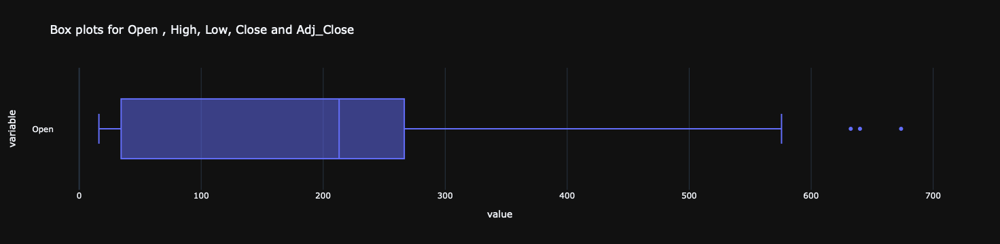

In [16]:
fig = px.box(
    Tesla,
    x=[Tesla["Open"]],
    template="plotly_dark",
    title="Box plots for Open , High, Low, Close and Adj_Close",
)
fig.show()

In [17]:
Tesla

,Open,High,Low,Close,Adj Close,Volume,date,year,month,day,...,SMA_5,SMA_10,RSI,MACD,MACD_signal,MA50,MA10,Shares,Close1,Profit
Date,,,,,,,,,,,,,,,,,,,,,
2010-06-29,19.000000,25.000000,17.540001,23.889999,23.889999,18766300,2010-06-29,2010,6,29,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,23.830000,0.000000
2010-06-30,25.790001,30.420000,23.299999,23.830000,23.830000,17187100,2010-06-30,2010,6,30,...,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,0,21.959999,0.000000
2010-07-01,25.000000,25.920000,20.270000,21.959999,21.959999,8218800,2010-07-01,2010,7,1,...,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,0,19.200001,0.000000
2010-07-02,23.000000,23.100000,18.709999,19.200001,19.200001,5139800,2010-07-02,2010,7,2,...,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,0,16.110001,0.000000
2010-07-06,20.000000,20.000000,15.830000,16.110001,16.110001,6866900,2010-07-06,2010,7,6,...,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,0,15.800000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-01-28,568.489990,576.809998,558.080017,566.900024,566.900024,11788500,2020-01-28,2020,1,28,...,562.360010,541.707001,73.404463,44.844805,42.681788,418.773402,545.911005,1,580.989990,14.089966
2020-01-29,575.690002,589.799988,567.429993,580.989990,580.989990,17801500,2020-01-29,2020,1,29,...,566.300012,545.911005,72.209166,45.090134,43.163457,423.406202,550.218005,1,640.809998,59.820008
2020-01-30,632.419983,650.880005,618.000000,640.809998,640.809998,29005700,2020-01-30,2020,1,30,...,568.586011,550.218005,82.015666,49.540463,44.438858,429.179001,562.449005,1,650.570007,9.760009


In [18]:
Tesla_monthly = (
    Tesla[
        [
            "Open",
            "High",
            "Low",
            "Close",
            "Adj Close",
            "Volume",
            "VWAP",
            "EMA_9",
            "EMA_22",
            "SMA_5",
            "SMA_10",
            "RSI",
            "MACD",
            "MACD_signal",
            "MA50",
            "MA10",
            "Shares",
            "Close1",
            "Profit",
        ]
    ]
    .resample("MS")
    .first()
)
Tesla_monthly

,Open,High,Low,Close,Adj Close,Volume,VWAP,EMA_9,EMA_22,SMA_5,SMA_10,RSI,MACD,MACD_signal,MA50,MA10,Shares,Close1,Profit
Date,,,,,,,,,,,,,,,,,,,
2010-06-01,19.000000,25.000000,17.540001,23.889999,23.889999,18766300,21.270001,23.889999,23.889999,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,0,23.830000,0.000000
2010-07-01,25.000000,25.920000,20.270000,21.959999,21.959999,8218800,23.784595,23.858421,23.859333,20.998000,19.084000,0.000000,NaN,NaN,NaN,19.084000,0,19.200001,0.000000
2010-08-01,20.500000,20.969999,20.330000,20.920000,20.920000,718100,20.863248,20.193975,20.027914,20.502000,20.723000,65.108696,0.333391,-0.185978,NaN,20.624000,0,21.950001,0.000000
2010-09-01,19.620001,20.690001,19.600000,20.450001,20.450001,494900,20.702416,19.516195,19.614259,19.740000,19.469000,71.428589,0.037039,-0.099201,19.833600,19.637000,0,21.059999,0.000000
2010-10-01,20.690001,20.750000,20.309999,20.600000,20.600000,597700,20.748644,20.608967,20.333688,20.884000,20.591000,49.369753,0.189577,0.203378,20.183800,20.628000,1,20.990000,0.390000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-10-01,241.500000,245.949997,239.130005,244.690002,244.690002,6162600,224.072804,236.782199,234.023105,235.494000,239.420000,47.996671,2.907840,2.752285,232.874600,239.410001,1,243.130005,-1.559997
2019-11-01,316.320007,316.480011,309.799988,313.309998,313.309998,6383900,225.060401,281.125754,259.969439,320.398004,292.238002,76.902504,20.589600,15.745334,249.761800,297.874001,1,317.470001,4.160003
2019-12-01,329.399994,336.380005,328.690002,334.869995,334.869995,6074500,226.456096,332.234752,306.618505,331.906006,342.826001,43.406449,10.762768,15.933753,292.914601,341.095999,1,336.200012,1.330017


In [19]:
pandas_profiling.ProfileReport(Tesla)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

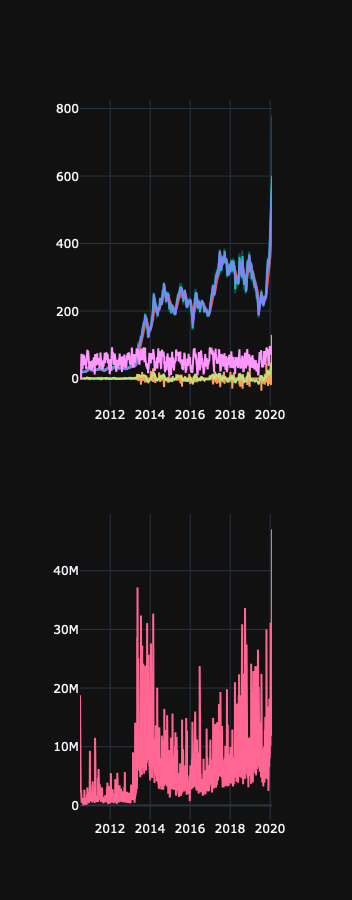

In [20]:
fig = go.Figure()
fig = make_subplots(rows=2, cols=1)


fig.add_trace(go.Scatter(x=Tesla.date, y=Tesla.EMA_9, name="EMA 9"))
fig.add_trace(go.Scatter(x=Tesla.date, y=Tesla.EMA_22, name="EMA 22"))
fig.add_trace(go.Scatter(x=Tesla.date, y=Tesla.SMA_5, name="SMA 5"))
fig.add_trace(go.Scatter(x=Tesla.date, y=Tesla.SMA_10, name="SMA 10"))


fig.add_trace(go.Scatter(x=Tesla.date, y=Tesla.Profit, name="Profit"))
fig.add_trace(go.Scatter(x=Tesla.date, y=Tesla.Close, name="Close", opacity=0.3))
fig.add_trace(go.Scatter(x=Tesla.date, y=Tesla.Volume, name="Volume"), row=2, col=1)
fig.add_trace(
    go.Scatter(x=Tesla.date, y=Tesla["MACD_signal"], name="Signal line"), row=1, col=1
)
fig.add_trace(go.Scatter(x=Tesla.date, y=Tesla.RSI, name="RSI"))
fig.update_layout(
    height=900, margin={"t": 100}, title_x=0.5, showlegend=False, template="plotly_dark"
)

fig.show()

In [21]:
import pandas as pd

pd.set_option("display.max_rows", None)
pd.set_option("display.max_columns", None)

import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns

# plotting stuff
from pandas.plotting import lag_plot

colorMap = sns.light_palette("blue", as_cmap=True)
# plt.rcParams.update({'font.size': 12})


# garbage collector to keep RAM in check
import gc

# install dabl
!pip install dabl > /dev/null
import dabl

# install datatable
!pip install datatable > /dev/null
import datatable as dt
from IPython.display import Image

/opt/homebrew/anaconda3/envs/tensorflow_env/lib/python3.7/site-packages/sklearn/experimental/enable_hist_gradient_boosting.py:17: UserWarning:

Since version 1.0, it is not needed to import enable_hist_gradient_boosting anymore. HistGradientBoostingClassifier and HistGradientBoostingRegressor are now stable and can be normally imported from sklearn.ensemble.



In [22]:
import copy

%matplotlib inline
import warnings
from pathlib import Path

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pytorch_forecasting
import pytorch_lightning as pl
import torch
import torch.nn as nn
from pytorch_forecasting import Baseline, TemporalFusionTransformer, TimeSeriesDataSet
from pytorch_forecasting.data import GroupNormalizer
from pytorch_forecasting.metrics import SMAPE, PoissonLoss, QuantileLoss
from pytorch_forecasting.models.temporal_fusion_transformer.tuning import (
    optimize_hyperparameters,
)
from pytorch_lightning.callbacks import EarlyStopping, LearningRateMonitor

warnings.filterwarnings("ignore")

/opt/homebrew/anaconda3/envs/tensorflow_env/lib/python3.7/site-packages/torchmetrics/utilities/prints.py:36: UserWarning:

Torchmetrics v0.9 introduced a new argument class property called `full_state_update` that has
                not been set for this class (SMAPE). The property determines if `update` by
                default needs access to the full metric state. If this is not the case, significant speedups can be
                achieved and we recommend setting this to `False`.
                We provide an checking function
                `from torchmetrics.utilities import check_forward_no_full_state`
                that can be used to check if the `full_state_update=True` (old and potential slower behaviour,
                default for now) or if `full_state_update=False` can be used safely.
                



# What Is the Volume-Weighted Average Price (VWAP)?
### The volume-weighted average price (VWAP) is a technical analysis indicator used on intraday charts that resets at the start of every new trading session.

### It's a trading benchmark that represents the average price a security has traded at throughout the day, based on both volume and price.

### VWAP is important because it provides traders with pricing insight into both the trend and value of a security.

### KEY TAKEAWAYS
- The volume-weighted average price (VWAP) appears as a single line on intraday charts.
- It looks similar to a moving average line, but smoother.
- VWAP represents a view of price action throughout a single day's trading session.
- Retail and professional traders may use the VWAP to help them determine intraday price trends.
- VWAP typically is most useful to short-term traders 

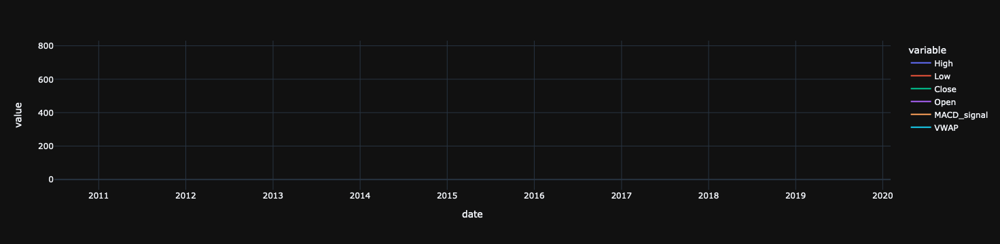

In [23]:
fig = px.line(
    Tesla,
    x="date",
    y=[
        Tesla["High"],
        Tesla["Low"],
        Tesla["Close"],
        Tesla["Open"],
        Tesla["MACD_signal"],
        Tesla["VWAP"],
    ],
    template="plotly_dark",
)

fig.show()

In [24]:
Tesla.head()

,Open,High,Low,Close,Adj Close,Volume,date,year,month,day,VWAP,EMA_9,EMA_22,SMA_5,SMA_10,RSI,MACD,MACD_signal,MA50,MA10,Shares,Close1,Profit
Date,,,,,,,,,,,,,,,,,,,,,,,
2010-06-29,19.000000,25.00,17.540001,23.889999,23.889999,18766300,2010-06-29,2010,6,29,21.270001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,23.830000,0.0
2010-06-30,25.790001,30.42,23.299999,23.830000,23.830000,17187100,2010-06-30,2010,6,30,23.942234,23.889999,23.889999,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0,21.959999,0.0
2010-07-01,25.000000,25.92,20.270000,21.959999,21.959999,8218800,2010-07-01,2010,7,1,23.784595,23.858421,23.859333,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0,19.200001,0.0
2010-07-02,23.000000,23.10,18.709999,19.200001,19.200001,5139800,2010-07-02,2010,7,2,23.484454,23.157896,23.197880,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0,16.110001,0.0
2010-07-06,20.000000,20.00,15.830000,16.110001,16.110001,6866900,2010-07-06,2010,7,6,22.803685,22.007011,22.130814,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0,15.800000,0.0


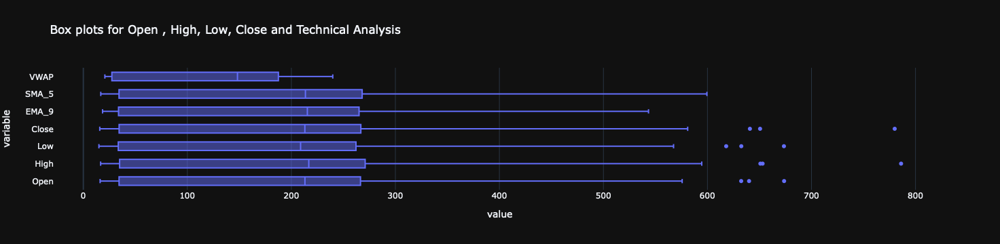

In [25]:
fig = px.box(
    Tesla,
    x=[
        Tesla["Open"],
        Tesla["High"],
        Tesla["Low"],
        Tesla["Close"],
        Tesla["EMA_9"],
        Tesla["SMA_5"],
        Tesla["VWAP"],
    ],
    template="plotly_dark",
    title="Box plots for Open , High, Low, Close and Technical Analysis ",
)
fig.show()

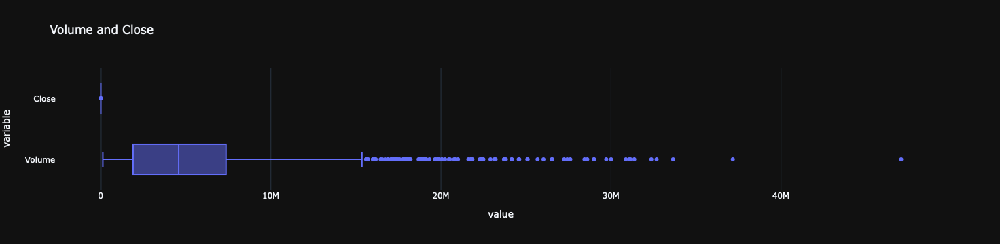

In [26]:
fig = px.box(
    Tesla,
    x=[Tesla["Volume"], Tesla["Close"]],
    template="plotly_dark",
    title="Volume and Close ",
)
fig.show()

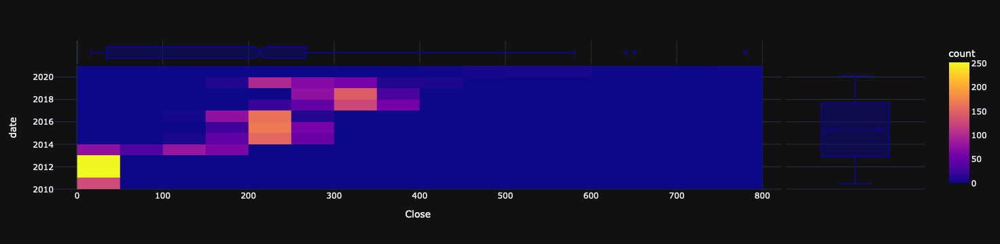

In [27]:
fig = px.density_heatmap(
    Tesla,
    x="Close",
    y="date",
    marginal_x="box",
    marginal_y="box",
    template="plotly_dark",
)
fig.show()

## Project Overview

## Investment firms, hedge funds, and even individuals have been utilizing financial models to comprehend market behavior better and make profitable investments and trades. The abundance of "data" accessible and available in the form of chronicled stock prices and company performance insights make it suitable for machine learning algorithms to process and conduct quantitative analysis to build predictive models.

## The new age of algorithms has dawned upon us.

In [28]:
from plotly.subplots import make_subplots
from statsmodels.tsa.seasonal import DecomposeResult, seasonal_decompose


def plot_seasonal_decompose(
    result: DecomposeResult,
    dates: pd.Series = None,
    title: str = "Seasonal Decomposition",
):
    x_values = dates if dates is not None else np.arange(len(result.observed))
    return (
        make_subplots(
            rows=4,
            cols=1,
            subplot_titles=["Observed", "Trend", "Seasonal", "Residuals"],
        )
        .add_trace(
            go.Scatter(x=x_values, y=result.observed, mode="lines", name="Observed"),
            row=1,
            col=1,
        )
        .add_trace(
            go.Scatter(x=x_values, y=result.trend, mode="lines", name="Trend"),
            row=2,
            col=1,
        )
        .add_trace(
            go.Scatter(x=x_values, y=result.seasonal, mode="lines", name="Seasonal"),
            row=3,
            col=1,
        )
        .add_trace(
            go.Scatter(x=x_values, y=result.resid, mode="lines", name="Residual"),
            row=4,
            col=1,
        )
        .update_layout(
            height=900,
            title=f"<b>{title}</b>",
            margin={"t": 100},
            title_x=0.5,
            showlegend=False,
            template="plotly_dark",
        )
    )

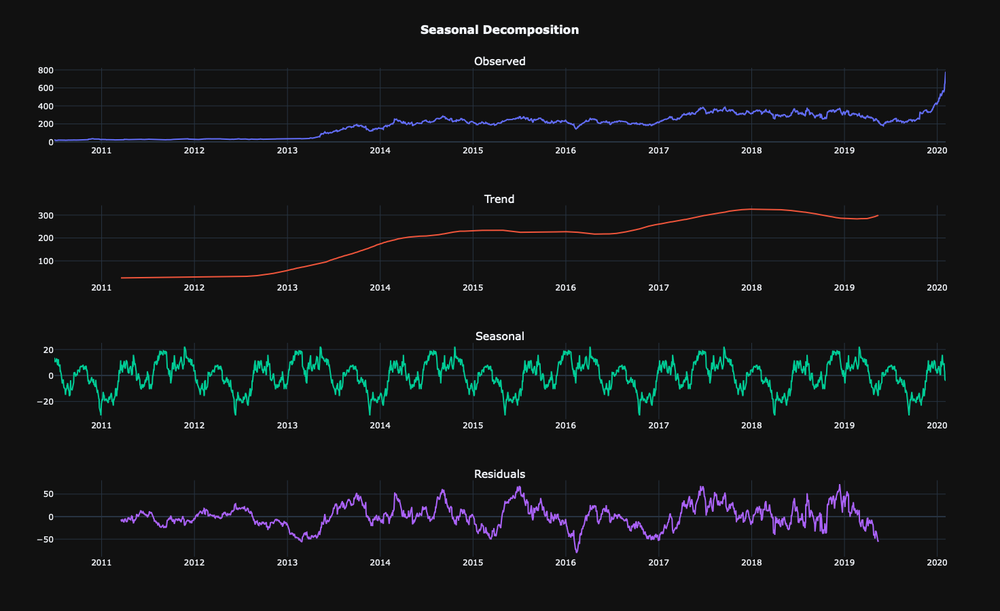

In [29]:
import pandas as pd
from statsmodels.tsa.seasonal import seasonal_decompose

data = Tesla
decomposition = seasonal_decompose(data["Close"], model="additive", period=365)

fig = plot_seasonal_decompose(decomposition, dates=data["date"])
fig.show()

In [30]:
import datetime as dt
import statistics

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from formulas import *
from sklearn.preprocessing import MinMaxScaler

%matplotlib inline

In [31]:
timeSeries = Tesla.loc[:, ["Close"]]

ts = timeSeries

In [32]:
# Resampling to daily frequency
data = Tesla.resample("D").mean()

# Resampling to monthly frequency
data_month = Tesla.resample("M").mean()

# Resampling to annual frequency
data_year = Tesla.resample("A-DEC").mean()

# Resampling to quarterly frequency
data_Q = Tesla.resample("Q-DEC").mean()

In [33]:
from statsmodels.tsa.stattools import adfuller

adfuller_test = adfuller(data_month["Close"])

print("Test statistic: ", adfuller_test[0])
print("p-value: ", adfuller_test[1])
print("Critical Values:", adfuller_test[4])

Test statistic:  0.664922210860135
p-value:  0.9891111954986297
Critical Values: {'1%': -3.489589552580676, '5%': -2.887477210140433, '10%': -2.580604145195395}


Our first criteria for stationary is constant mean. So we fail because mean is not constant as you can see from plot(black line) above . (no stationary)
Second one is constant variance. It looks like constant. (yes stationary)
Third one is that If the test statistic is less than the critical value, we can say that time series is stationary. Lets look:
test statistic = -1.4 and critical values = {'1%': -3.439229783394421, '5%': -2.86545894814762, '10%': -2.5688568756191392}. Test statistic is bigger than the critical values. (no stationary)
As a result, we sure that our time series is not stationary.
Lets make time series stationary at the next part.

In [34]:
series = Tesla.Close
from statsmodels.tsa.stattools import adfuller


def adf_test(timeseries):
    # Perform Dickey-Fuller test:
    print("Results of Dickey-Fuller Test:")
    dftest = adfuller(timeseries, autolag="AIC")
    dfoutput = pd.Series(
        dftest[0:4],
        index=[
            "Test Statistic",
            "p-value",
            "#Lags Used",
            "Number of Observations Used",
        ],
    )
    for key, value in dftest[4].items():
        dfoutput["Critical Value (%s)" % key] = value
    print(dfoutput)


adf_test(series)

Results of Dickey-Fuller Test:
Test Statistic                    1.400069
p-value                           0.997114
#Lags Used                       18.000000
Number of Observations Used    2397.000000
Critical Value (1%)              -3.433081
Critical Value (5%)              -2.862747
Critical Value (10%)             -2.567412
dtype: float64


In [35]:
Tesla["day"] = pd.to_datetime(Tesla["day"])

In [36]:
Tesla.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 2416 entries, 2010-06-29 to 2020-02-03
Data columns (total 23 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Open         2416 non-null   float64       
 1   High         2416 non-null   float64       
 2   Low          2416 non-null   float64       
 3   Close        2416 non-null   float64       
 4   Adj Close    2416 non-null   float64       
 5   Volume       2416 non-null   int64         
 6   date         2416 non-null   object        
 7   year         2416 non-null   int64         
 8   month        2416 non-null   int64         
 9   day          2416 non-null   datetime64[ns]
 10  VWAP         2416 non-null   float64       
 11  EMA_9        2415 non-null   float64       
 12  EMA_22       2415 non-null   float64       
 13  SMA_5        2411 non-null   float64       
 14  SMA_10       2406 non-null   float64       
 15  RSI          2415 non-null   float64 

In [37]:
# df['Date'] = pd.to_datetime(df['Date'])
Tesla.set_index("year", inplace=True)
Tesla.set_index("month", inplace=True)
Tesla.set_index("day", inplace=True)
Tesla.set_index("date", inplace=True)


#  1.7 Shifting and lags


#Rules and study 
#df.shift(periods=1).head()
#df.rolling(7).mean().head(14)
#

<AxesSubplot:xlabel='date'>

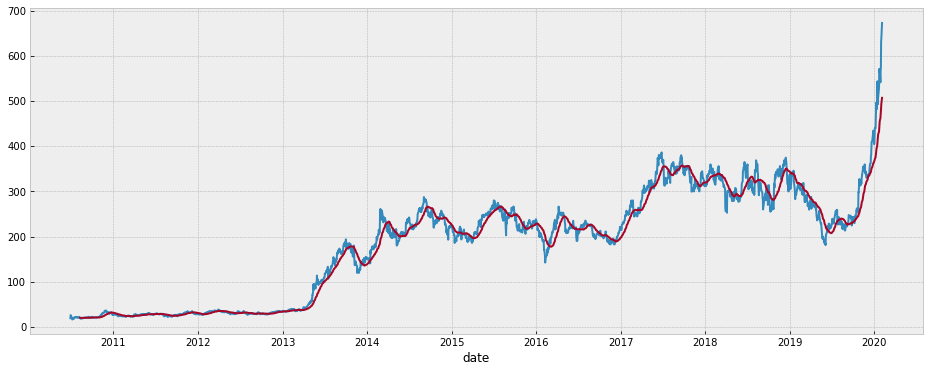

In [38]:
Tesla["Open"].plot()
Tesla.rolling(30).mean()["Close"].plot(figsize=(16, 6))

<AxesSubplot:xlabel='date'>

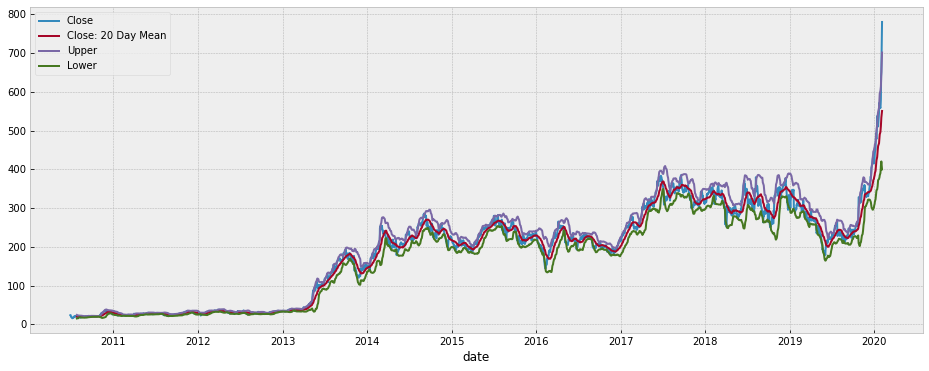

In [39]:
 # Close 20 MA
Tesla['Close: 20 Day Mean'] = Tesla['Close'].rolling(20).mean()

 #Upper = 20MA + 2*std(20)
Tesla['Upper'] = Tesla['Close: 20 Day Mean'] + 2*(Tesla['Close'].rolling(20).std())

#Lower = 20MA - 2*std(20)
Tesla['Lower'] = Tesla['Close: 20 Day Mean'] - 2*(Tesla['Close'].rolling(20).std())

 #Plot Close
Tesla[['Close','Close: 20 Day Mean','Upper','Lower']].plot(figsize=(16,6))

In [40]:
Tesla.head()

,Open,High,Low,Close,Adj Close,Volume,VWAP,EMA_9,EMA_22,SMA_5,SMA_10,RSI,MACD,MACD_signal,MA50,MA10,Shares,Close1,Profit,Close: 20 Day Mean,Upper,Lower
date,,,,,,,,,,,,,,,,,,,,,,
2010-06-29,19.000000,25.00,17.540001,23.889999,23.889999,18766300,21.270001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,23.830000,0.0,NaN,NaN,NaN
2010-06-30,25.790001,30.42,23.299999,23.830000,23.830000,17187100,23.942234,23.889999,23.889999,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0,21.959999,0.0,NaN,NaN,NaN
2010-07-01,25.000000,25.92,20.270000,21.959999,21.959999,8218800,23.784595,23.858421,23.859333,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0,19.200001,0.0,NaN,NaN,NaN
2010-07-02,23.000000,23.10,18.709999,19.200001,19.200001,5139800,23.484454,23.157896,23.197880,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0,16.110001,0.0,NaN,NaN,NaN
2010-07-06,20.000000,20.00,15.830000,16.110001,16.110001,6866900,22.803685,22.007011,22.130814,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0,15.800000,0.0,NaN,NaN,NaN


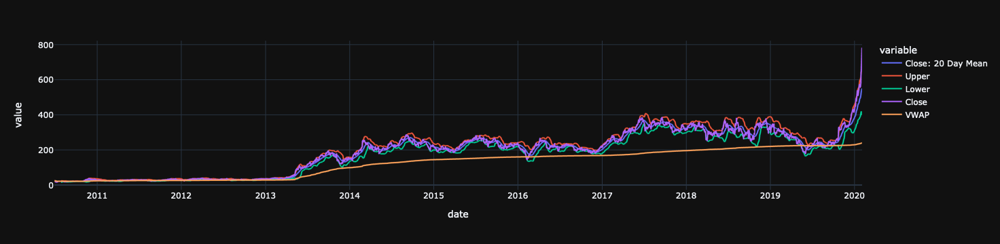

In [41]:
fig = px.line(
    Tesla,
    x=Tesla.index,
    y=[
        Tesla["Close: 20 Day Mean"],
        Tesla["Upper"],
        Tesla["Lower"],
        Tesla["Close"],
        Tesla["VWAP"],
    ],
    template="plotly_dark",
)

fig.show()

In [42]:
# import statsmodels.api as sm

In [43]:
# from statsmodels.tsa.seasonal import seasonal_decompose
# result = seasonal_decompose(Tesla['Adj Close'], model='additive',period=365 )

____ 
# EWMA Models

EWMA stands for Exponentially Weighted Moving Average.

We saw that with pd.rolling() we can create a simple model that describes a trend of a time series - these are referred to as Simple Moving Averages (SMA).

A few of the weaknesses of SMA's include:

A smaller windows will lead to more noise, rather than signal
It will always lag the size of the window
It will never reach the peak or valley of the data due to averaging
It doesn't inform us about future behavior, it really just describes trends in the data
Extreme historical values can skew the SMA
To recap, here's how we can calculate the 30-day SMA for TSLA:


Exponentially Weighted Moving Averages solve some of these issues, in particular:

EWMA allows you to reduce the lag time from SMA and puts more weight on values that occur more recently
The amount of weight applied to the recent values depends on the parameters used in the EWMA and the number of periods in the window size
Here's how we can create an EWMA model:

In [44]:
df = Tesla

<AxesSubplot:xlabel='date'>

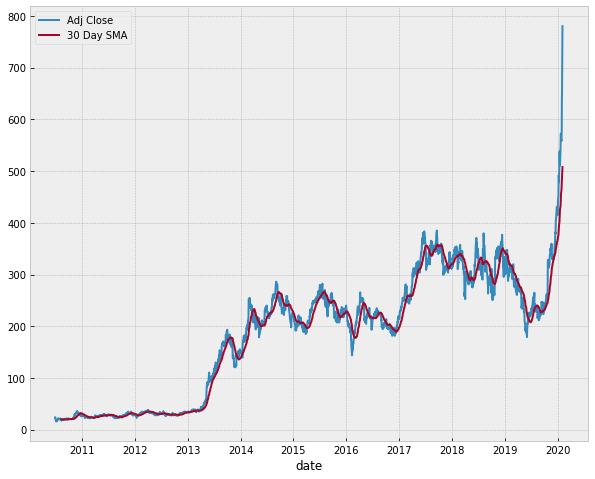

In [45]:
# create 1 month SMA off of Adj Close
df["30 Day SMA"] = df["Adj Close"].rolling(window=30).mean()

# plot SMA & Adj Close
df[["Adj Close", "30 Day SMA"]].plot(figsize=(10, 8))

<AxesSubplot:xlabel='date'>

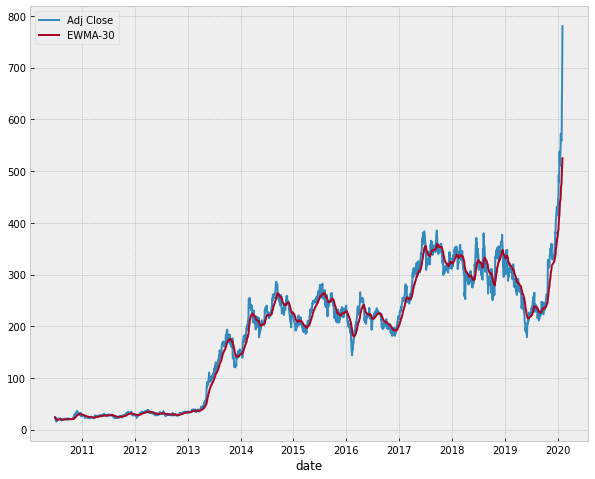

In [46]:
# create EWMA
df["EWMA-30"] = df["Adj Close"].ewm(span=30).mean()

# plot EWMA
df[["Adj Close", "EWMA-30"]].plot(figsize=(10, 8))

In [47]:
Tesla = df

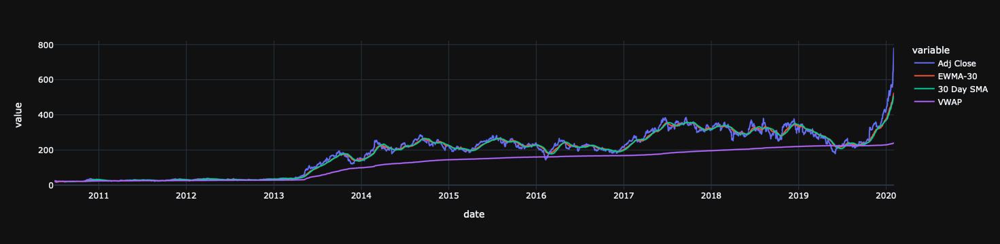

In [48]:
fig = px.line(
    Tesla,
    x=Tesla.index,
    y=[Tesla["Adj Close"], Tesla["EWMA-30"], Tesla["30 Day SMA"], Tesla["VWAP"]],
    template="plotly_dark",
)

fig.show()

In [49]:
# Tesla["Close"].asfreq('M').interpolate().plot(legend=True)

In [50]:
# Tesla["Close"].asfreq('M').interpolate().plot(legend=True)
# Tesla['shifted'] = Tesla["Close"].asfreq('M').interpolate().shift(10).plot(legend=True)
# Tesla['shifted_1'] = Tesla["Close"].asfreq('M').interpolate().shift(15).plot(legend=True)
# Tesla['shifted_2'] = Tesla["Close"].asfreq('M').interpolate().shift(-10).plot(legend=True)
# Tesla['shifted_3'] = Tesla["Close"].asfreq('M').interpolate().shift(-15).plot(legend=True)


# shifted.legend(['Close','Close_lagged'])
# plt.title('Closing price of Oracle over time (Monthly frequency) - raw and lagged')
# plt.show()

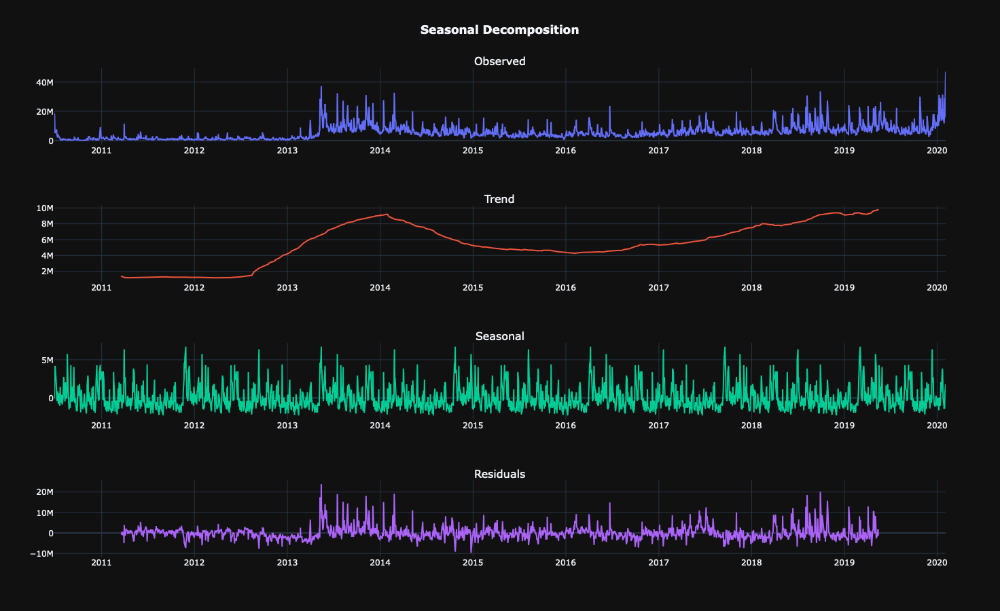

In [51]:
data = Tesla
decomposition = seasonal_decompose(data["Volume"], model="additive", period=365)

fig = plot_seasonal_decompose(decomposition, dates= Tesla.index)
fig.show()

# Random Walk, White Noise 

 Random Walk
A random walk is a mathematical object, known as a stochastic or random process, that describes a path that consists of a succession of random steps on some mathematical space such as the integers.

In general if we talk about stocks, Today's Price = Yesterday's Price + Noise




One of the simplest and yet most important models in time series forecasting is the random walk model. This model assumes that in each period the variable takes a random step away from its previous value, and the steps are independently and identically distributed in size (“i.i.d.”). This is equivalent to saying that the first difference of the variable is a series to which the mean model should be applied.

In other words, it predicts that all future values will equal the last observed value. This doesn’t really mean you expect them to all be the same, but just that you think they are equally likely to be higher or lower, and you are staying on the fence as far as point predictions are concerned.

Because of this, this method is usually known as naive method.

In [52]:
# Plotting white noise
#rcParams['figure.figsize'] = 16, 6
#white_noise = np.random.normal(loc=0, scale=1, size=1000)
#_ = plt.title('Generate Whitenoise')
# loc is mean, scale is variance
#plt.plot(white_noise)

In [53]:
# Plotting autocorrelation of white noise
#plot_acf(white_noise,lags=20)
#plt.show()


In [54]:
#seed(42)
#rcParams['figure.figsize'] = 16, 6
#random_walk = normal(loc=0, scale=0.01, size=1000)
#_ = plt.title('Plot random walk')
#plt.plot(random_walk)
#plt.show()


In [55]:
adsad

### new decomposed_apple_close.trend.plot() 
##_ = plt.title('Decomposed Apple stock closing price over time')



###decomposed_oracle_close.trend.plot()
## _ = plt.title('Decomposed Oracle stock closing price over time')


NameError: name 'adsad' is not defined

In [ ]:
#df = Tesla

In [ ]:
#train_size = .70
#n = df.shape[0]
#test_start_index = round(train_size * n)

#train = df[:test_start_index] # everything up (not including) to the test_start_index
#test = df[test_start_index:] # everything from the test_start_index to the end

#plt.plot(train.index, train.Close)
#plt.plot(test.index, test.Close)



In [ ]:
# Transform categorical variables into dummy variables
#Tesla = pd.get_dummies(Tesla, drop_first=True)  # To avoid dummy trap
#Tesla.head()

In [ ]:
pandas_profiling.ProfileReport(train)

In [ ]:
#fig = make_subplots(rows=2, cols=1)
#fig = px.line(
    #train,
    #x=train.index,
    #y=[train["Adj Close"], train["Close"], train["Open"]],
    #template="plotly_dark",
#)

#fig.show()

In [ ]:
# Debug
#print('Inputs: \n', train.head())
#print('Outputs: \n', train.head())

In [ ]:
#train.isnull().sum()

In [ ]:
#from sklearn.model_selection import train_test_split
#from sklearn.model_selection import learning_curve
#from sklearn.model_selection import validation_curve
#from sklearn.model_selection import cross_val_score
#from sklearn.linear_model import LogisticRegression
#logreg = LogisticRegression()
#logreg.fit(train)

In [ ]:
#train.Close.resample('6H').mean().plot(title='6 hour average')

In [ ]:
#y = train.Close

In [ ]:
#y#.head()

In [ ]:
#train.Close = y

In [ ]:
#df = pd(y, index_col='datetime', parse_dates=True).sort_index()

In [ ]:
# train.Close = pd.to_datetime(train.Close)
#Tesla.set_index("year", inplace=True)

In [ ]:
#train.Close.head()

In [ ]:
##df = train.set_index('Close').resample('1H').mean()
##print (df)

In [ ]:
import statsmodels.formula.api as smf
import statsmodels.tsa.api as smt
import statsmodels.api as sm
import scipy.stats as scs

import matplotlib.pyplot as plt
import matplotlib as mpl
%matplotlib inline

In [ ]:
def tsplot(y, lags=None, figsize=(15, 10), style='bmh'):
    if not isinstance(y, pd.Series):
        y = pd.Series(y)
    with plt.style.context(style):    
        fig = plt.figure(figsize=figsize)
        #mpl.rcParams['font.family'] = 'Ubuntu Mono'
        layout = (3, 2)
        ts_ax = plt.subplot2grid(layout, (0, 0), colspan=2)
        acf_ax = plt.subplot2grid(layout, (1, 0))
        pacf_ax = plt.subplot2grid(layout, (1, 1))
        qq_ax = plt.subplot2grid(layout, (2, 0))
        pp_ax = plt.subplot2grid(layout, (2, 1))
        
        y.plot(ax=ts_ax)
        ts_ax.set_title('Time Series Analysis Plots')
        smt.graphics.plot_acf(y, lags=lags, ax=acf_ax, alpha=0.05)
        smt.graphics.plot_pacf(y, lags=lags, ax=pacf_ax, alpha=0.05)
        sm.qqplot(y, line='s', ax=qq_ax)
        qq_ax.set_title('QQ Plot')        
        scs.probplot(y, sparams=(y.mean(), y.std()), plot=pp_ax)

        plt.tight_layout()
    return 

In [ ]:
_ = tsplot(np.diff(Tesla.Close), lags=30)

In [ ]:
_ = tsplot(np.diff(Tesla.Volume), lags=30)

# Linear Models

Linear models aka trend models represent a TS that can be graphed using a straight line. The basic equation is:
x
t
=
a
0
+
a
1
t
+
b

The value of the time series is determined by the coefficients, 
a
0
,
a
1
 and time. An example could be a company's sales that increase by the same amount at each time step. For a hypthtical example, consider a company who's stock price was a 100$ to start, and increase by 50c at every time step.




In [ ]:
# simulate linear trend

w = np.random.randn(250)
x = np.empty_like(w)

a0 = 100.
a1 = 0.5
for t in range(len(w)):
    x[t] = a0 + a1*t + w[t]
    
_ = tsplot(x, lags=30)  

In [ ]:
_ = tsplot(np.diff(x), lags=30)

In [ ]:
def plotMovingAverage(series, window, plot_intervals=False, scale=1.96, plot_anomalies=False):

    """
        series - dataframe with timeseries
        window - rolling window size 
        plot_intervals - show confidence intervals
        plot_anomalies - show anomalies 

    """
    rolling_mean = series.rolling(window=window).mean()

    plt.figure(figsize=(15,5))
    plt.title("Moving average\n window size = {}".format(window))
    plt.plot(rolling_mean, "g", label="Rolling mean trend")

    # Plot confidence intervals for smoothed values
    if plot_intervals:
        mae = mean_absolute_error(series[window:], rolling_mean[window:])
        deviation = np.std(series[window:] - rolling_mean[window:])
        lower_bond = rolling_mean - (mae + scale * deviation)
        upper_bond = rolling_mean + (mae + scale * deviation)
        plt.plot(upper_bond, "r--", label="Upper Bond / Lower Bond")
        plt.plot(lower_bond, "r--")
        
        # Having the intervals, find abnormal values
        if plot_anomalies:
            anomalies = pd.DataFrame(index=series.index, columns=series.columns)
            anomalies[series<lower_bond] = series[series<lower_bond]
            anomalies[series>upper_bond] = series[series>upper_bond]
            plt.plot(anomalies, "ro", markersize=10)
        
    plt.plot(series[window:], label="Actual values")
    plt.legend(loc="upper left")
    plt.grid(True)

In [ ]:
plotMovingAverage(Tesla, window = 30, plot_intervals=False, scale=1.96, plot_anomalies=False)

In [ ]:
plotMovingAverage(Tesla, 100, plot_intervals=True)

In [65]:
from sklearn.model_selection import TimeSeriesSplit # you have everything done for you

def timeseriesCVscore(params, series, loss_function=mean_squared_error, slen=24):
    """
        Returns error on CV  
        
        params - vector of parameters for optimization
        series - dataset with timeseries
        slen - season length for Holt-Winters model
    """
    # errors array
    errors = []
    
    values = series.values
    alpha, beta, gamma = params
    
    # set the number of folds for cross-validation
    tscv = TimeSeriesSplit(n_splits=3) 
    
    # iterating over folds, train model on each, forecast and calculate error
    for train, test in tscv.split(values):

        model = HoltWinters(series=values[train], slen=slen, 
                            alpha=alpha, beta=beta, gamma=gamma, n_preds=len(test))
        model.triple_exponential_smoothing()
        
        predictions = model.result[-len(test):]
        actual = values[test]
        error = loss_function(predictions, actual)
        errors.append(error)
        
    return np.mean(np.array(errors))


In [56]:
class HoltWinters:
    
    """
    Holt-Winters model with the anomalies detection using Brutlag method
    
    # series - initial time series
    # slen - length of a season
    # alpha, beta, gamma - Holt-Winters model coefficients
    # n_preds - predictions horizon
    # scaling_factor - sets the width of the confidence interval by Brutlag (usually takes values from 2 to 3)
    
    """
    
    
    def __init__(self, series, slen, alpha, beta, gamma, n_preds, scaling_factor=1.96):
        self.series = series
        self.slen = slen
        self.alpha = alpha
        self.beta = beta
        self.gamma = gamma
        self.n_preds = n_preds
        self.scaling_factor = scaling_factor
        
        
    def initial_trend(self):
        sum = 0.0
        for i in range(self.slen):
            sum += float(self.series[i+self.slen] - self.series[i]) / self.slen
        return sum / self.slen  
    
    def initial_seasonal_components(self):
        seasonals = {}
        season_averages = []
        n_seasons = int(len(self.series)/self.slen)
        # let's calculate season averages
        for j in range(n_seasons):
            season_averages.append(sum(self.series[self.slen*j:self.slen*j+self.slen])/float(self.slen))
        # let's calculate initial values
        for i in range(self.slen):
            sum_of_vals_over_avg = 0.0
            for j in range(n_seasons):
                sum_of_vals_over_avg += self.series[self.slen*j+i]-season_averages[j]
            seasonals[i] = sum_of_vals_over_avg/n_seasons
        return seasonals   

          
    def triple_exponential_smoothing(self):
        self.result = []
        self.Smooth = []
        self.Season = []
        self.Trend = []
        self.PredictedDeviation = []
        self.UpperBond = []
        self.LowerBond = []
        
        seasonals = self.initial_seasonal_components()
        
        for i in range(len(self.series)+self.n_preds):
            if i == 0: # components initialization
                smooth = self.series[0]
                trend = self.initial_trend()
                self.result.append(self.series[0])
                self.Smooth.append(smooth)
                self.Trend.append(trend)
                self.Season.append(seasonals[i%self.slen])
                
                self.PredictedDeviation.append(0)
                
                self.UpperBond.append(self.result[0] + 
                                      self.scaling_factor * 
                                      self.PredictedDeviation[0])
                
                self.LowerBond.append(self.result[0] - 
                                      self.scaling_factor * 
                                      self.PredictedDeviation[0])
                continue
                
            if i >= len(self.series): # predicting
                m = i - len(self.series) + 1
                self.result.append((smooth + m*trend) + seasonals[i%self.slen])
                
                # when predicting we increase uncertainty on each step
                self.PredictedDeviation.append(self.PredictedDeviation[-1]*1.01) 
                
            else:
                val = self.series[i]
                last_smooth, smooth = smooth, self.alpha*(val-seasonals[i%self.slen]) + (1-self.alpha)*(smooth+trend)
                trend = self.beta * (smooth-last_smooth) + (1-self.beta)*trend
                seasonals[i%self.slen] = self.gamma*(val-smooth) + (1-self.gamma)*seasonals[i%self.slen]
                self.result.append(smooth+trend+seasonals[i%self.slen])
                
                # Deviation is calculated according to Brutlag algorithm.
                self.PredictedDeviation.append(self.gamma * np.abs(self.series[i] - self.result[i]) 
                                               + (1-self.gamma)*self.PredictedDeviation[-1])
                     
            self.UpperBond.append(self.result[-1] + 
                                  self.scaling_factor * 
                                  self.PredictedDeviation[-1])

            self.LowerBond.append(self.result[-1] - 
                                  self.scaling_factor * 
                                  self.PredictedDeviation[-1])

            self.Smooth.append(smooth)
            self.Trend.append(trend)
            self.Season.append(seasonals[i%self.slen])


In [76]:
from scipy.optimize import minimize 

data = T.Volume[:-20] # leave some data for testing

# initializing model parameters alpha, beta and gamma
x = [0, 0, 0] 

# Minimizing the loss function 
opt = minimize(timeseriesCVscore, x0=x, 
               args=(data, mean_squared_log_error), 
               method="TNC", bounds = ((0, 1), (0, 1), (0, 1))
              )

# Take optimal values...
alpha_final, beta_final, gamma_final = opt.x
print(alpha_final, beta_final, gamma_final)

# ...and train the model with them, forecasting for the next 50 hours
model = HoltWinters(data, slen = 24, 
                    alpha = alpha_final, 
                    beta = beta_final, 
                    gamma = gamma_final, 
                    n_preds = 50, scaling_factor = 3)
model.triple_exponential_smoothing()

ValueError: Mean Squared Logarithmic Error cannot be used when targets contain negative values.

In [60]:
%matplotlib inline

In [63]:
import warnings                                  # `do not disturbe` mode
warnings.filterwarnings('ignore')

import numpy as np                               # vectors and matrices
import pandas as pd                              # tables and data manipulations
import matplotlib.pyplot as plt                  # plots
import seaborn as sns                            # more plots

from dateutil.relativedelta import relativedelta # working with dates with style
from scipy.optimize import minimize              # for function minimization

import statsmodels.formula.api as smf            # statistics and econometrics
import statsmodels.tsa.api as smt
import statsmodels.api as sm
import scipy.stats as scs

from itertools import product                    # some useful functions
from tqdm import tqdm_notebook



%matplotlib inline

In [68]:
 sklearn.metrics.mean_squared_log_error

ModuleNotFoundError: No module named 'sklearn.metrics.mean_squared_log_error'

In [69]:
from sklearn.metrics import mean_squared_log_error

In [74]:
T = pd.read_csv("TSLA.csv")

In [79]:
T.isnull().mean()

Date         0.0
Open         0.0
High         0.0
Low          0.0
Close        0.0
Adj Close    0.0
Volume       0.0
dtype: float64

TypeError: '<' not supported between instances of 'str' and 'int'

In [81]:
from statsmodels.tsa.filters.hp_filter import hpfilter  # Hodrick Prescott filter for cyclic & trend separation
from statsmodels.tsa.seasonal import seasonal_decompose # Error Trend Seasonality decomposition

# holt winters 
from statsmodels.tsa.holtwinters import SimpleExpSmoothing   # single exponential smoothing as in ewm of pandas
from statsmodels.tsa.holtwinters import ExponentialSmoothing # double and triple exponential smoothing


In [82]:
df = pd.read_csv("tesla.csv")

In [83]:
df.Date = pd.to_datetime(df.Date)
df.set_index("Date", inplace=True)
df.head()

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2010-06-29,19.000000,25.00,17.540001,23.889999,23.889999,18766300
2010-06-30,25.790001,30.42,23.299999,23.830000,23.830000,17187100
2010-07-01,25.000000,25.92,20.270000,21.959999,21.959999,8218800
2010-07-02,23.000000,23.10,18.709999,19.200001,19.200001,5139800
2010-07-06,20.000000,20.00,15.830000,16.110001,16.110001,6866900


In [ ]:
# Resampling to daily frequency
data = Tesla.resample("D").mean()

# Resampling to monthly frequency
data_month = Tesla.resample("M").mean()

# Resampling to annual frequency
data_year = Tesla.resample("A-DEC").mean()

# Resampling to quarterly frequency
data_Q = Tesla.resample("Q-DEC").mean()

In [110]:
from pylab import rcParams
rcParams['figure.figsize'] = (12,5)
rcParams['xtick.labelsize'] = 12
rcParams['ytick.labelsize'] = 12
rcParams['axes.labelsize'] = 12

In [88]:
df.head()

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2010-06-29,19.000000,25.00,17.540001,23.889999,23.889999,18766300
2010-06-30,25.790001,30.42,23.299999,23.830000,23.830000,17187100
2010-07-01,25.000000,25.92,20.270000,21.959999,21.959999,8218800
2010-07-02,23.000000,23.10,18.709999,19.200001,19.200001,5139800
2010-07-06,20.000000,20.00,15.830000,16.110001,16.110001,6866900


In [89]:
span = 12
alpha = 2/(span+1)

In [90]:
df.columns

Index(['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume'], dtype='object')

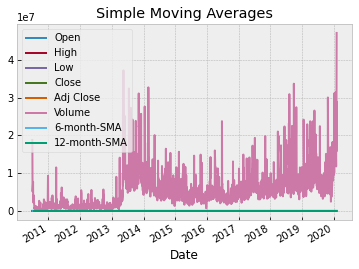

In [92]:
df.dropna(inplace=True)

df['6-month-SMA'] = df['Close'].rolling(window=6).mean()

df['12-month-SMA'] = df['Close'].rolling(window=12).mean()

df.plot(title='Simple Moving Averages');


In [93]:
df.columns

Index(['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume', '6-month-SMA',
       '12-month-SMA'],
      dtype='object')

In [94]:
df['ewma12'] = df['Close'].ewm(span=12,adjust=False).mean()

In [95]:
df.columns

Index(['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume', '6-month-SMA',
       '12-month-SMA', 'ewma12'],
      dtype='object')

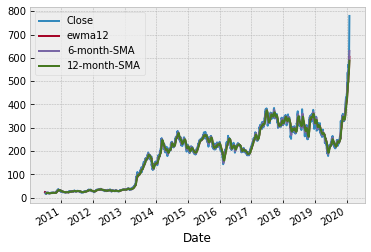

In [96]:
df[['Close','ewma12','6-month-SMA','12-month-SMA']].plot();

In [107]:
df['SES12'] = SimpleExpSmoothing(df['Close']).fit(smoothing_level=alpha,optimized=False).fittedvalues.shift(-1)

In [108]:
df.head()

,Open,High,Low,Close,Adj Close,Volume,6-month-SMA,12-month-SMA,ewma12,SES12
Date,,,,,,,,,,
2010-06-29,19.000000,25.00,17.540001,23.889999,23.889999,18766300,NaN,NaN,23.889999,23.889999
2010-06-30,25.790001,30.42,23.299999,23.830000,23.830000,17187100,NaN,NaN,23.880768,23.880768
2010-07-01,25.000000,25.92,20.270000,21.959999,21.959999,8218800,NaN,NaN,23.585265,23.585265
2010-07-02,23.000000,23.10,18.709999,19.200001,19.200001,5139800,NaN,NaN,22.910609,22.910609
2010-07-06,20.000000,20.00,15.830000,16.110001,16.110001,6866900,NaN,NaN,21.864362,21.864362


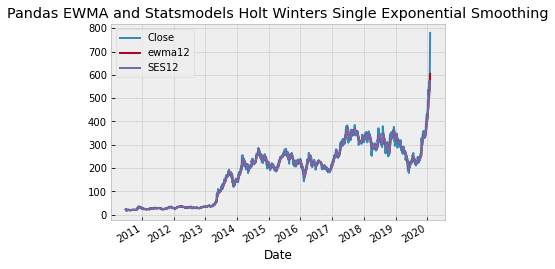

In [109]:
df[['Close','ewma12','SES12']].plot(title='Pandas EWMA and Statsmodels Holt Winters Single Exponential Smoothing');

In [112]:
df['DES12'] = ExponentialSmoothing(df['Close'],trend='add').fit().fittedvalues.shift(-1)

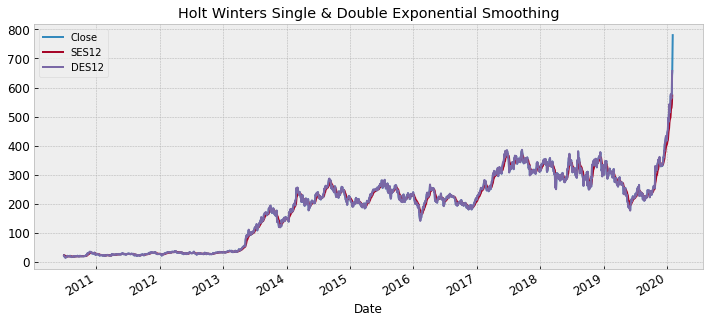

In [113]:
df[['Close','SES12','DES12']].plot(title='Holt Winters Single & Double Exponential Smoothing');


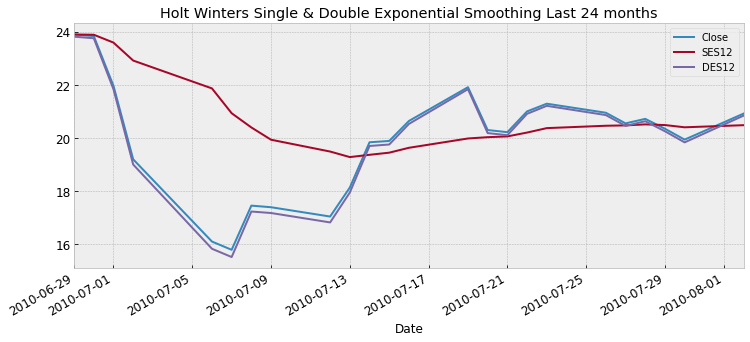

In [117]:
df[['Close','SES12','DES12']].iloc[:24].plot(title='Holt Winters Single & Double Exponential Smoothing Last 24 months').autoscale(axis='x',tight=True);

In [119]:
df['DES12_mul'] = ExponentialSmoothing(df['Close'],trend='mul').fit().fittedvalues.shift(-1)

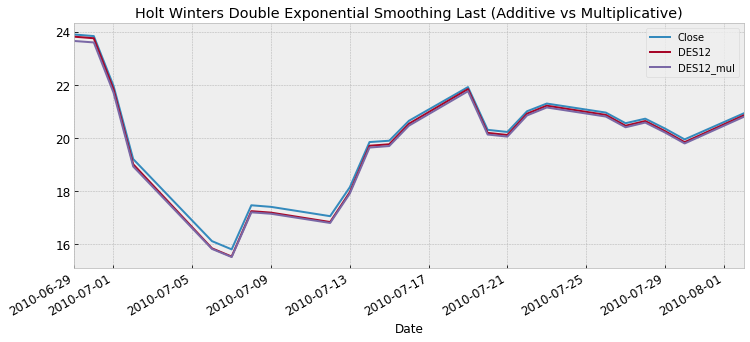

In [120]:
df[['Close','DES12','DES12_mul']].iloc[:24].plot(title='Holt Winters Double Exponential Smoothing Last (Additive vs Multiplicative)').autoscale(axis='x',tight=True);

In [121]:
df['TESadd12'] = ExponentialSmoothing(df['Close'],trend='add',seasonal='add',seasonal_periods=12).fit().fittedvalues

In [122]:
df['TESmul12'] = ExponentialSmoothing(df['Close'],trend='mul',seasonal='mul',seasonal_periods=12).fit().fittedvalues

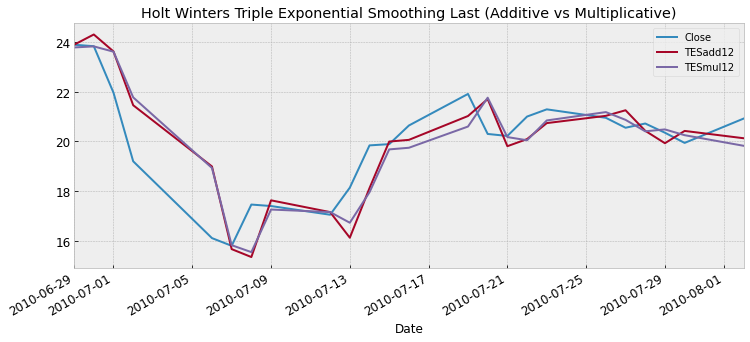

In [123]:
df[['Close','TESadd12','TESmul12']].iloc[:24].plot(title='Holt Winters Triple Exponential Smoothing Last (Additive vs Multiplicative)').autoscale(axis='x',tight=True);

In [125]:
len(df)

2416

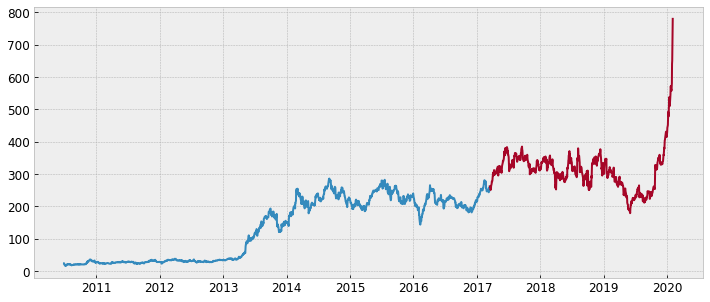

In [127]:
## df = pd.read_csv(url, index_col='datetime', parse_dates=True).sort_index()

train_size = .70
n = df.shape[0]
test_start_index = round(train_size * n)

train = df[:test_start_index] # everything up (not including) to the test_start_index
test = df[test_start_index:] # everything from the test_start_index to the end

plt.plot(train.index, train.Close)
plt.plot(test.index, test.Close)

In [129]:
fitted_model = ExponentialSmoothing(train.Close,trend='mul',seasonal='mul',seasonal_periods=12).fit()

In [130]:
test_predictions = fitted_model.forecast(36).rename('HW Test Forecast')

In [131]:
test_predictions[:10]

1691    262.752823
1692    263.318428
1693    263.164591
1694    263.756129
1695    262.860309
1696    263.371575
1697    263.855331
1698    263.502340
1699    264.174221
1700    265.175785
Name: HW Test Forecast, dtype: float64

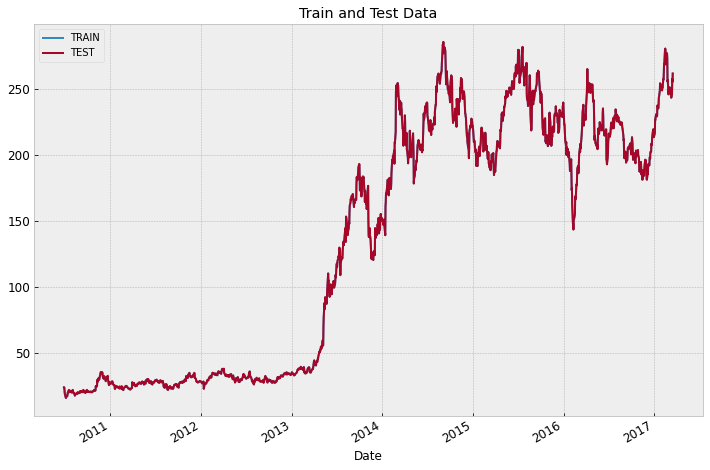

In [132]:
train.Close.plot(legend=True,label='TRAIN')
train.Close.plot(legend=True,label='TEST',figsize=(12,8))
plt.title('Train and Test Data');

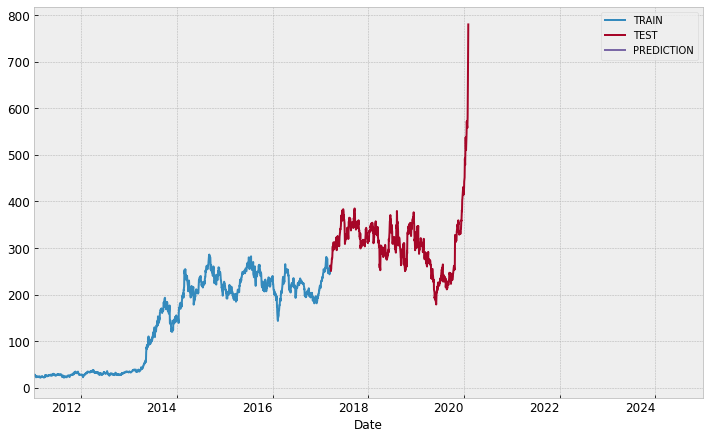

In [139]:
train.Close.plot(legend=True,label='TRAIN')
test.Close.plot(legend=True,label='TEST',figsize=(12,8))
test_predictions.plot(legend=True,label='PREDICTION',xlim=['2011-01-01','2025-01-01']);

In [140]:
from sklearn.metrics import mean_absolute_error,mean_squared_error